In [44]:
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
import nibabel as nib
import matplotlib.pyplot as plt

In [3]:
path = '/workspace/RibCage/RibFrac431-image.nii'
Nifti_img  = nib.load(path)
nii_data = Nifti_img.get_fdata()
nii_aff  = Nifti_img.affine
nii_hdr  = Nifti_img.header
print(nii_aff ,'\n',nii_hdr)
print(nii_data.shape)

[[  -0.68359399    0.            0.          174.80299377]
 [   0.           -0.68359399    0.          175.        ]
 [   0.            0.            1.25       -469.35800171]
 [   0.            0.            0.            1.        ]] 
 <class 'nibabel.nifti1.Nifti1Header'> object, endian='<'
sizeof_hdr      : 348
data_type       : b''
db_name         : b''
extents         : 0
session_error   : 0
regular         : b'r'
dim_info        : 0
dim             : [  3 512 512 369   1   1   1   1]
intent_p1       : 0.0
intent_p2       : 0.0
intent_p3       : 0.0
intent_code     : none
datatype        : int32
bitpix          : 32
slice_start     : 0
pixdim          : [1.       0.683594 0.683594 1.25     0.       0.       0.       0.      ]
vox_offset      : 0.0
scl_slope       : nan
scl_inter       : nan
slice_end       : 0
slice_code      : unknown
xyzt_units      : 2
cal_max         : 0.0
cal_min         : 0.0
slice_duration  : 0.0
toffset         : 0.0
glmax           : 0
glmin           :

In [4]:
nii_data[:,:,0]

array([[-3024., -3024., -3024., ..., -3024., -3024., -3024.],
       [-3024., -3024., -3024., ..., -3024., -3024., -3024.],
       [-3024., -3024., -3024., ..., -3024., -3024., -3024.],
       ...,
       [-3024., -3024., -3024., ..., -3024., -3024., -3024.],
       [-3024., -3024., -3024., ..., -3024., -3024., -3024.],
       [-3024., -3024., -3024., ..., -3024., -3024., -3024.]])

In [11]:
nii_min=[]
for slice_number in range(nii_data.shape[2]):
    nii_min.append(np.min(nii_data[:,:,slice_number]))
print(np.min(nii_min))

-3024.0


In [9]:
nii_max=[]
for slice_number in range(nii_data.shape[2]):
    nii_max.append(np.max(nii_data[:,:,slice_number]))
print(np.max(nii_max))

3071.0


In [13]:
np.max(nii_data)

3071.0

In [15]:
nii_data.shape

(512, 512, 369)

In [16]:
nii_data.shape[2]

369

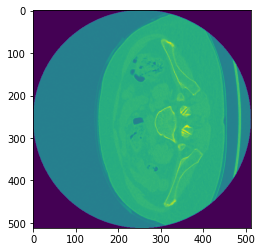

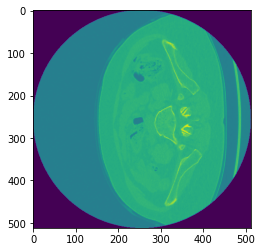

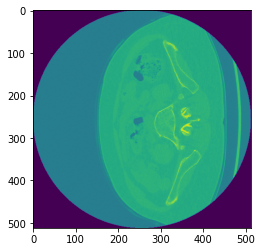

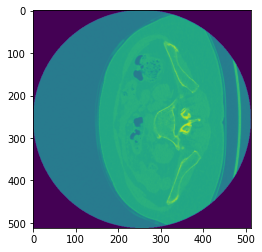

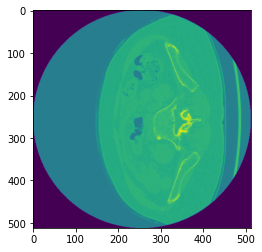

...

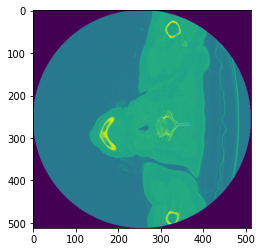

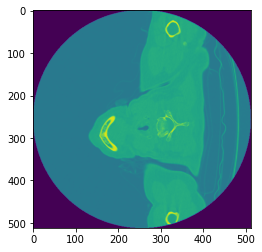

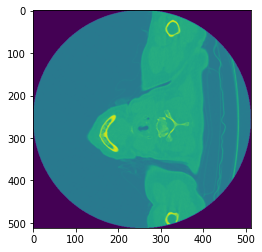

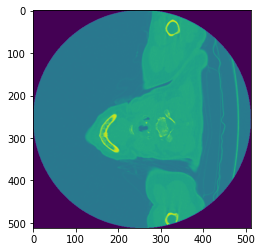

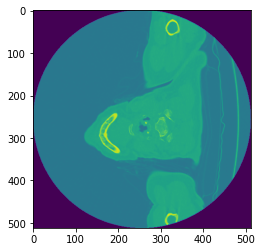

In [11]:
if(len(nii_data.shape)==3):
   for slice_Number in range(nii_data.shape[2]):
       plt.imshow(nii_data[:,:,slice_Number ])
       plt.show()

In [ ]:
if(len(nii_data.shape)==3):
   for slice_Number in range(nii_data.shape[2]):
       plt.imshow(nii_data[:,:,slice_Number ], cmap='gray')
       plt.show()

In [17]:
threshold_value = 700

thresholded_data = np.where(nii_data > threshold_value, nii_data, 0)

In [18]:
np.min(thresholded_data)

0.0

In [19]:
np.max(thresholded_data)

3071.0

In [20]:
thresholded_data.shape

(512, 512, 369)

In [21]:
np.min(nii_data)

-3024.0

In [22]:
np.max(nii_data)

3071.0

In [23]:
np.any(thresholded_data == 200)

False

In [24]:
threshold_value = 150

thresholded_data = np.where(nii_data > threshold_value, nii_data, 0)

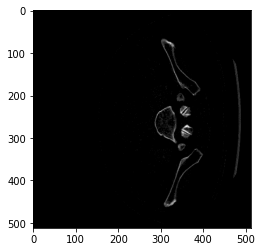

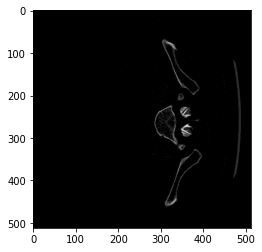

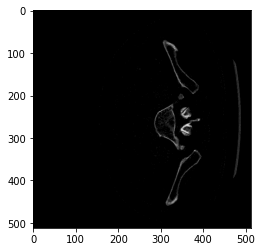

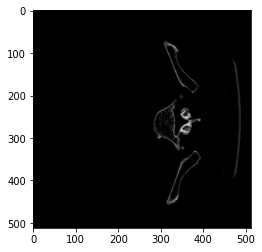

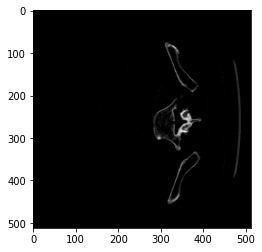

...

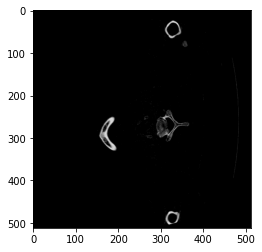

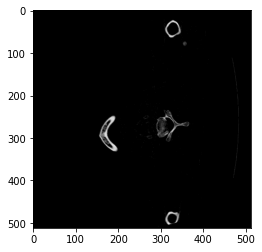

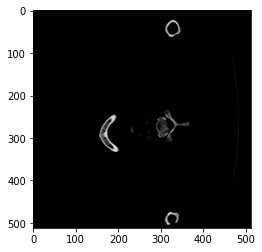

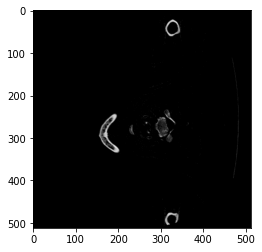

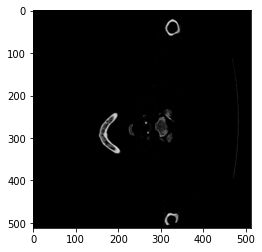

In [30]:
if(len(thresholded_data.shape)==3):
   for slice_Number in range(thresholded_data.shape[2]):
       plt.imshow(thresholded_data[:,:,slice_Number ], cmap='gray')
       plt.show()

In [25]:
thresholded_data.shape

(512, 512, 369)

In [45]:
def introduce_artifacts(data):
    artifact_data = np.copy(data)

    for slice_number in range(250,300):
        artifact_data[250:300, 100:250, slice_number] = 0
    
    return artifact_data

In [39]:
# def introduce_artifacts(data):
#     artifact_data = np.copy(data)
    
#     x_start, x_end = 100, 250
#     y_start, y_end = 250, 300
#     z_start, z_end = 200, 250
    
#     for slice_number in range(z_start,z_end):
#         artifact_data[x_start:x_end, y_start:y_end, slice_number] = 0
    
#     return artifact_data

In [40]:
artifact_data=introduce_artifacts(thresholded_data)

In [41]:
artifact_img = nib.Nifti1Image(artifact_data, nii_aff, nii_hdr)

In [42]:
# Save the new NIfTI image to a file
output_path = '/workspace/RibCage/RibFrac431-artifact-image.nii'
nib.save(artifact_img, output_path)

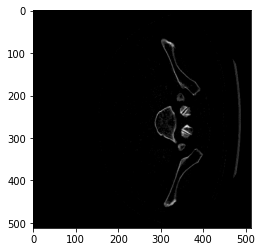

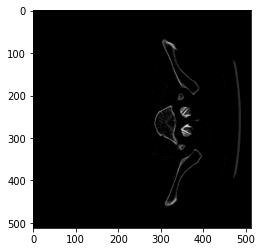

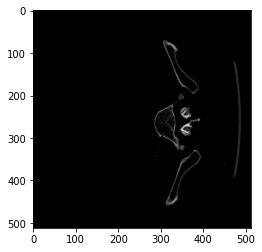

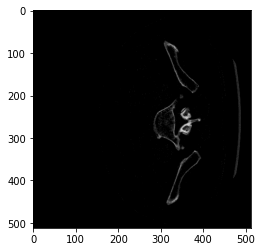

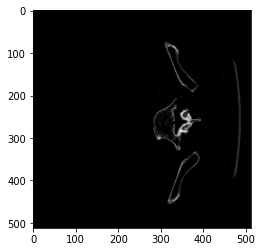

...

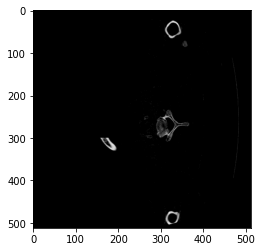

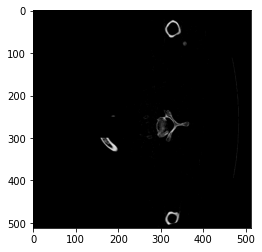

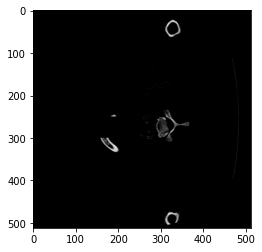

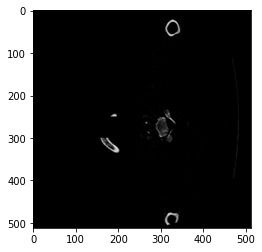

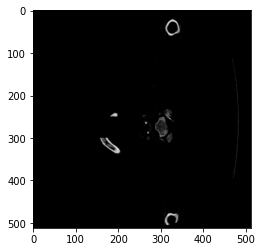

In [37]:
if(len(artifact_data.shape)==3):
   for slice_Number in range(artifact_data.shape[2]):
       plt.imshow(artifact_data[:,:,slice_Number ], cmap='gray')
       plt.show()

In [ ]:
import os
import zipfile
import nibabel as nib
def load_nii_data_from_zip(zip_file_path):
    nii_data_list = []
    with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
        for file_name in zip_ref.namelist():
            if file_name.endswith('.nii') or file_name.endswith('.nii.gz'):
                zip_ref.extract(file_name, './temp')
                nii_file_path = os.path.join('./temp', file_name)
                #print(nii_file_path)
                nii_img = nib.load(nii_file_path)
                #print(nii_img.shape)
                nii_data = nii_img.get_fdata()
                #print(nii_data.shape)
                nii_data_list.append(nii_data)
                os.remove(nii_file_path)
    return nii_data_list

zip_file_path='/workspace/RibCage/ribfrac-train-images.zip'
nii_dataset=load_nii_data_from_zip(zip_file_path)

In [50]:
len(nii_dataset)

80

In [51]:
nii_dataset[0]

array([[[-1024., -1024., -1024., ..., -1024., -1024., -1024.],
        [-1024., -1024., -1024., ..., -1024., -1024., -1024.],
        [-1024., -1024., -1024., ..., -1024., -1024., -1024.],
        ...,
        [-1024., -1024., -1024., ..., -1024., -1024., -1024.],
        [-1024., -1024., -1024., ..., -1024., -1024., -1024.],
        [-1024., -1024., -1024., ..., -1024., -1024., -1024.]],

       [[-1024., -1024., -1024., ..., -1024., -1024., -1024.],
        [-1024., -1024., -1024., ..., -1024., -1024., -1024.],
        [-1024., -1024., -1024., ..., -1024., -1024., -1024.],
        ...,
        [-1024., -1024., -1024., ..., -1024., -1024., -1024.],
        [-1024., -1024., -1024., ..., -1024., -1024., -1024.],
        [-1024., -1024., -1024., ..., -1024., -1024., -1024.]],

       [[-1024., -1024., -1024., ..., -1024., -1024., -1024.],
        [-1024., -1024., -1024., ..., -1024., -1024., -1024.],
        [-1024., -1024., -1024., ..., -1024., -1024., -1024.],
        ...,
        [-10

In [54]:
threshold_value = 150
thresholded_dataset=[]
for i in range(len(nii_dataset)):
    thresholded_data = np.where(nii_dataset[i] > threshold_value, nii_dataset[i], 0)
    thresholded_dataset.append(thresholded_data)

In [55]:
type(thresholded_data)

numpy.ndarray

In [ ]:
for i in range(len(nii_dataset))
artifact_data=introduce_artifacts(thresholded_data)

In [ ]:
print(thresholded_data.shape,artifact_data.shape)

In [38]:
train_data = torch.tensor(artifact_data, dtype=torch.float32)
train_labels = torch.tensor(thresholded_data, dtype=torch.float32)
val_data = torch.tensor(artifact_data, dtype=torch.float32)
val_labels = torch.tensor(thresholded_data, dtype=torch.float32)

In [39]:
train_dataset = TensorDataset(train_data, train_labels)
val_dataset = TensorDataset(val_data, val_labels)
train_loader = DataLoader(train_dataset, batch_size=1, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=1)

In [40]:
import torch
import torch.nn as nn

class UNet(nn.Module):
    def __init__(self):
        super(UNet, self).__init__()
        
        self.conv1 = nn.Conv2d(in_channels=369, out_channels=64, kernel_size=3, padding=1)
        self.relu1 = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding=1)
        self.relu2 = nn.ReLU(inplace=True)
        self.maxpool1 = nn.MaxPool2d(kernel_size=2, stride=2)
        
        self.conv3 = nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding=1)
        self.relu3 = nn.ReLU(inplace=True)
        self.conv4 = nn.Conv2d(in_channels=64, out_channels=369, kernel_size=3, padding=1)
        self.relu4 = nn.ReLU(inplace=True)
        self.upsample1 = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        
    def forward(self, x):
        x = self.conv1(x)
        print("Conv1 output shape:", x.shape)
        x = self.relu1(x)
        print("ReLU1 output shape:", x.shape)
        x = self.conv2(x)
        print("Conv2 output shape:", x.shape)
        x = self.relu2(x)
        print("ReLU2 output shape:", x.shape)
        x = self.maxpool1(x)
        print("MaxPool1 output shape:", x.shape)
        
        x = self.conv3(x)
        print("Conv3 output shape:", x.shape)
        x = self.relu3(x)
        print("ReLU3 output shape:", x.shape)
        x = self.conv4(x)
        print("Conv4 output shape:", x.shape)
        x = self.relu4(x)
        print("ReLU4 output shape:", x.shape)
        x = self.upsample1(x)
        print("Upsample1 output shape:", x.shape)
        
        return x

In [41]:
model = UNet()
criterion = dice_loss
optimizer = optim.Adam(model.parameters(), lr=0.001)

In [45]:
num_epochs = 10
for epoch in range(num_epochs):
    model.train()
    for inputs, targets in train_loader:
        optimizer.zero_grad()
        #inputs=inputs.reshape(1,512,512,369)
        #targets=targets.reshape(1,512,512,369)
        print(inputs.shape, targets.shape)
        outputs = model(inputs)
        loss = criterion(outputs, targets)
        loss.backward()
        optimizer.step()

model.eval()
val_loss = 0.0
with torch.no_grad():
    for inputs, targets in val_loader:
        outputs = model(inputs)
        val_loss += criterion(outputs, targets).item()

val_loss /= len(val_loader)
print(f'Validation Loss: {val_loss}')

torch.Size([1, 512, 369]) torch.Size([1, 512, 369])


RuntimeError: Given groups=1, weight of size [64, 369, 3, 3], expected input[1, 1, 512, 369] to have 369 channels, but got 1 channels instead